# HuBMAP + HPA fastai U-Net model training
A U-Net CNN model is used based on Resnet34 architecture for training. The size of all images of the training set are resized to 512x512 and no image data augmentation is performed on the dataset.<br>
The best model of this run is exported to a file in order for inference to be performed at a later step (inference notebook)

_Notes This notebook is using fastai v2._

In [1]:
from fastai.vision.all import *
from fastai.callback.all import *
from fastai.basics import *
import numpy as np
import pandas as pd
import PIL
import cv2

In [2]:
# A constant seed is used in order for the results to be reproducable
SEED = 88

In [3]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    #the following line gives ~10% speedup
    #but may lead to some stochasticity in the results 
#     torch.backends.cudnn.benchmark = True
    
seed_everything(SEED)

## Setting up the paths of training images and masks

In [4]:
path_mdl = Path('/kaggle/working')
path_mdl.ls()

(#1) [Path('/kaggle/working/__notebook__.ipynb')]

In [5]:
path_img=Path("../input/hubmap-organ-segmentation/train_images")
list_dir = [f.lower() for f in os.listdir(path_img)]   # Convert to lower case
fnames = L([path_img/f for f in sorted(list_dir)])
path_mask = Path("../input/hacking-the-human-body-annotation-masks/train_binary_masks")
mask_dir = [f.lower() for f in os.listdir(path_mask)]   # Convert to lower case
lbl_names = L([path_mask/f for f in sorted(mask_dir)])

fnames, lbl_names

((#351) [Path('../input/hubmap-organ-segmentation/train_images/10044.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10274.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10392.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10488.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10610.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10611.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10651.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10666.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10703.tiff'),Path('../input/hubmap-organ-segmentation/train_images/10892.tiff')...],
 (#351) [Path('../input/hacking-the-human-body-annotation-masks/train_binary_masks/10044.png'),Path('../input/hacking-the-human-body-annotation-masks/train_binary_masks/10274.png'),Path('../input/hacking-the-human-body-annotation-masks/train_binary_masks/10392.png'),Path('../input/hacking-the-human-body-annotation-

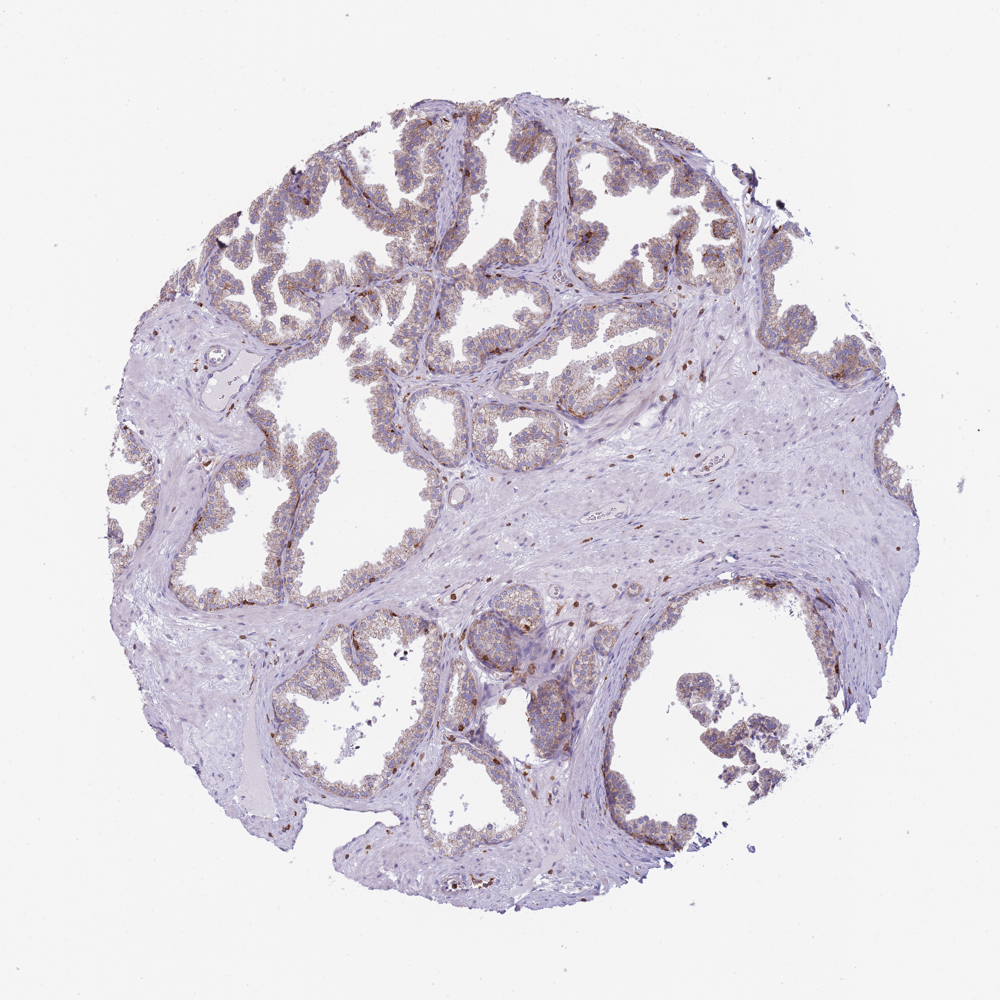

In [11]:
# A sample image
img_f = fnames[0]
Image.open(img_f)

In [13]:
import torch
from torchvision import transforms

# Convert the sample image to a tensor
convert_tensor = transforms.ToTensor()
ts = convert_tensor(img)
print(ts.shape)
ts

torch.Size([1, 3000, 3000])


tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]])

In [14]:
ims = [Image.open(fnames[i]) for i in range(8)]
im_masks = [Image.open(lbl_names[i]) for i in range(8)]

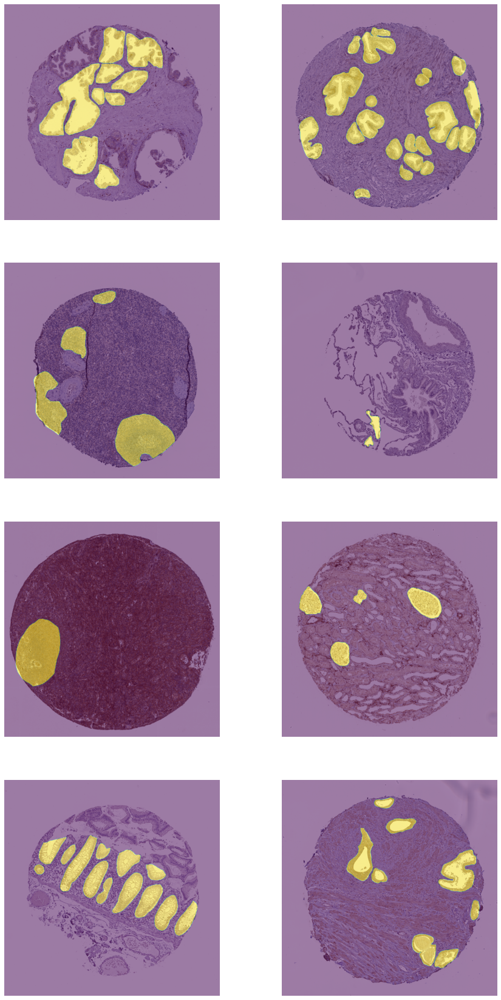

In [15]:
import matplotlib.pyplot as plt

# Show a few sample images of the training dataset 
# with their corresponding masks overlayed
fig, axes = plt.subplots(4,2,figsize=(15,30))
for i, ax in enumerate(axes.flat):
    ax = show_image(ims[i], ax=ax)
    show_image(im_masks[i], ax=ax, alpha=0.5)

In [16]:
def label_fn(x): return path_mask/f'{x.stem}.png'

In [17]:
img_f

Path('../input/hubmap-organ-segmentation/train_images/10044.tiff')

In [18]:
label_fn(img_f)

Path('../input/hacking-the-human-body-annotation-masks/train_binary_masks/10044.png')

In [19]:
codes = np.array(['A', 'B'], dtype='<U17')
codes

array(['A', 'B'], dtype='<U17')

## Loading the training set

Loading all the images of the training dataset into a fastai DataLoader. All the images are downsized to 512x512 and resampled with a Lanczos antialias filter for retaining as much information as possible.

In [20]:
img_size=512
item_tfms=[Resize(size=img_size, resamples=(Image.Resampling.LANCZOS, 0))]
dls = SegmentationDataLoaders.from_label_func(
    path_img, bs=8, fnames = fnames, label_func = label_fn, 
    codes = codes,
    seed=SEED,
    item_tfms=item_tfms
)

/opt/conda/lib/python3.7/site-packages/torch/_tensor.py:1142: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)


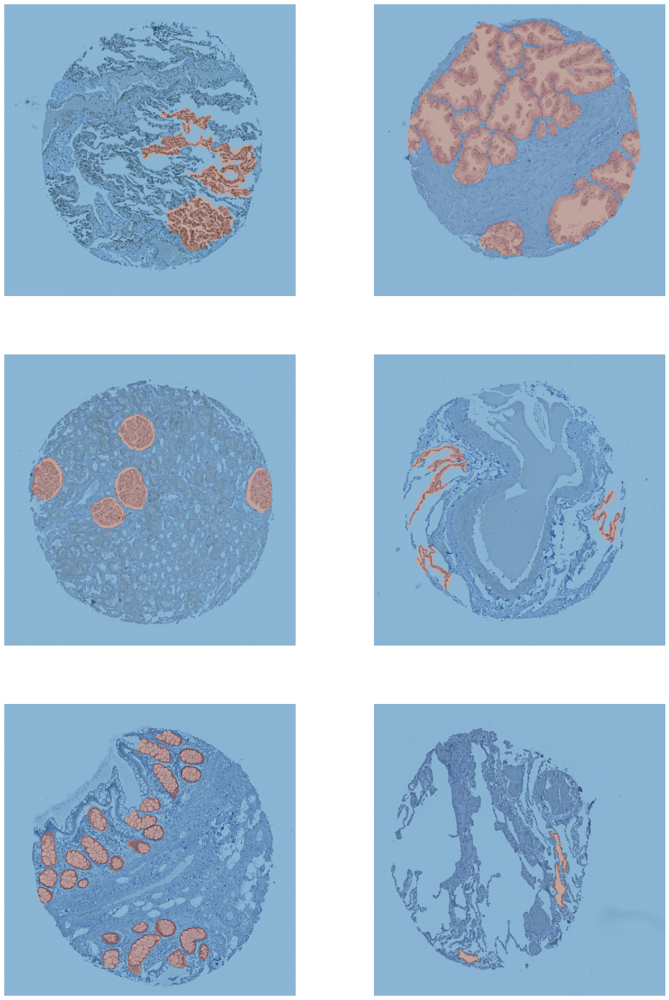

In [21]:
# Few sample images of the dataloader with their respecting masks 
dls.show_batch(max_n=6,nrows=3, figsize=(20,30))

## Creating and training the model

A U-Net CNN is used based on a resnet34 architecture and the mean dice coefficient is used as metric of accuracy, as instructed by the competition rules.


In [22]:
learn = unet_learner(dls, resnet34 , metrics=Dice())
learn.fine_tune(1)

In [23]:
# First run to find the best LR
learn.model_dir='/kaggle/working/'
learn.lr_find()

In [24]:
# Callbacks defined to save the model with the best accuracy, 
# to reduce LR in case of no progress and finally to do an early stopping 
cb1 = SaveModelCallback(monitor='dice', comp=np.greater, with_opt=True, fname='best-model')
cb2 = ReduceLROnPlateau(monitor='dice', min_delta=0.01, patience=2, min_lr=1e-4)
cb3 = EarlyStoppingCallback(monitor='dice', min_delta=0.01, comp=np.greater, patience=4)
cbs = [cb1, cb2, cb3]

# The hard-coded best LR is found from the previous cell
learn.fit_one_cycle(25, 3e-3, cbs=cbs)

In [25]:
# This step is run after the model has already been produced
# to get it ready for the final export
MODEL_NAME = "/kaggle/input/simple-fastai-baseline-and-submission/best-model"
learn.load(MODEL_NAME)
learn.fit_one_cycle(1, 1e-4)
learn.export(fname='/kaggle/working/export.pkl')